# Stock Price Prediction Using Reddit post (WallStreetBets) Sentiment Analysis

The main aim of this project to analyze the sentiments for a stock based on the post in the WallStreetBets group of Reddit. As we are aware that the stock market mainly works on how people feel about the market. Time and again we have noticed a huge mass of people are confident on a stock and even though the fundamentals are not that good, the stock has shown uptrend for a short period of time. It would be safe to say that people's confidence is one of the major key factor in stock market that decides a stocks movement. Through this project, we intend at capturing these small market swings to predict the future trends by analyzing the comments of a huge number of users for a particular stock.

The planned strategy for this project is to:</b>
<ol>
    <li> Extract comments from daily discussions of Reddit group the WallstreetBets using <b>API</b></li>
    <li> Analyze the text and process the data and smoothen the curves using fourier transform</li>
    <li> Perform Vadar Sentiment Analysis </li>
    <li> Train a model using TPOT and analyze the parameters</li>
    <li> Train a model using LSTM</li>
    <li> Predict the price movement of the stock in advance</li>
</ol>

The intended audience for this project would be any ordinary person who wishes to trade in stocks with little insights about the technical whereabouts of finances or organizations. It could even be very useful for professional  traders who don't wish to miss out on any big market swings. For the professional traders, this model prediction could work for stock selection after which they would perform fundametal analysis of the stock.

In [129]:
import numpy as np
import pandas as pd
pd.set_option('display.max_rows', 300)
import praw #reddit data api
import ffn #for loading financial data
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sn
from tpot import TPOTRegressor
from sklearn.model_selection import train_test_split
import re #regex
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer #VADER sentiment model
import warnings
warnings.filterwarnings('ignore')
import requests
import json
import csv
import time
import datetime

In [2]:
import tensorflow as tf
from tensorflow import keras
tf.test.gpu_device_name() #run to make sure tensorflow is connected to gpu (if applicable)

''

In [3]:
#function to get data from pushshift api
def getPushshiftData(query, after, before, sub):
    url = 'https://api.pushshift.io/reddit/search/submission/?title='+str(query)+'&size=1000&after='+str(after)+'&before='+str(before)+'&subreddit='+str(sub)
    print(url)
    r = requests.get(url)
    data = json.loads(r.text)
    return data['data']

#get relevant data from data extracted using previous function
def collectSubData(subm):
    subData = [subm['id'], subm['title'], subm['url'], datetime.datetime.fromtimestamp(subm['created_utc']).date()]
    try:
        flair = subm['link_flair_text']
    except KeyError:
        flair = "NaN"
    subData.append(flair)
    subStats.append(subData)
    
#Subreddit to query
sub='wallstreetbets'
#before and after dates
before = "1594339200" #july 10 2020
after = "1498867200" #july 1 2017
#query string
query = "Daily Discussion Thread"
subCount = 0
subStats = []

data = getPushshiftData(query, after, before, sub)
# Will run until all posts have been gathered 
# from the 'after' date up until before date
while len(data) > 0:
    for submission in data:
        collectSubData(submission)
        subCount+=1
    # Calls getPushshiftData() with the created date of the last submission
    print(len(data))
    print(str(datetime.datetime.fromtimestamp(data[-1]['created_utc'])))
    after = data[-1]['created_utc']
    data = getPushshiftData(query, after, before, sub)
    

#organize data into dataframe
data={}
ids=[]
titles=[]
urls=[]
dates=[]
flairs=[]
for stat in subStats:
    ids.append(stat[0])
    titles.append(stat[1])
    urls.append(stat[2])
    dates.append(stat[3])
    flairs.append(stat[4])
data['id']=ids
data['title']=titles
data['url']=urls
data['date']=dates
data['flair']=flairs
df_1=pd.DataFrame(data)
df_1=df_1[df_1['flair']=='Daily Discussion']

https://api.pushshift.io/reddit/search/submission/?title=Daily Discussion Thread&size=1000&after=1498867200&before=1594339200&subreddit=wallstreetbets
100
2018-06-01 08:09:21
https://api.pushshift.io/reddit/search/submission/?title=Daily Discussion Thread&size=1000&after=1527854961&before=1594339200&subreddit=wallstreetbets
99
2018-11-16 06:05:48
https://api.pushshift.io/reddit/search/submission/?title=Daily Discussion Thread&size=1000&after=1542366348&before=1594339200&subreddit=wallstreetbets
100
2019-05-29 07:05:46
https://api.pushshift.io/reddit/search/submission/?title=Daily Discussion Thread&size=1000&after=1559127946&before=1594339200&subreddit=wallstreetbets
100
2019-11-15 06:05:22
https://api.pushshift.io/reddit/search/submission/?title=Daily Discussion Thread&size=1000&after=1573815922&before=1594339200&subreddit=wallstreetbets
100
2020-04-23 06:11:55
https://api.pushshift.io/reddit/search/submission/?title=Daily Discussion Thread&size=1000&after=1587636715&before=1594339200&

In [4]:
#connect to reddit api
reddit = praw.Reddit(client_id='bOyBNTnDDXjuEg', client_secret='nesBa9F5e6WOquj6RGpCQd303tw', user_agent='bot2')

#collect comments using praw
comments_by_day=[]
for url in df_1['url'].tolist():
    try:
        submission = reddit.submission(url=url)
        submission.comments.replace_more(limit=0)
        comments=list([(comment.body) for comment in submission.comments])
    except:
        comments=None
    comments_by_day.append(comments)

In [5]:
## run vader sentiment analyzer

analyser = SentimentIntensityAnalyzer()

scores=[]
for comments in comments_by_day:
    sentiment_score=0
    try:
        for comment in comments:
            sentiment_score=sentiment_score+analyser.polarity_scores(comment)['compound']
    except TypeError:
        sentiment_score=0
    
    scores.append(sentiment_score)
    
df_1['sentiment score']=scores

In [6]:
df_1['sentiment score']

139    -9.8812
141   -17.4916
144    -0.8501
147     3.9756
149    -4.0217
150     6.7434
152    -0.4200
153     9.3534
154   -19.5164
156    -8.7256
157    -6.3886
158     1.0557
159     2.4015
161     4.8040
167     5.6168
168    -6.1190
169     7.0444
170    11.7021
171   -11.0540
172    -2.3003
173     0.6296
176   -10.2018
177   -20.0830
178   -10.8590
179   -22.4497
181   -14.2759
183   -24.8163
184   -19.3970
185   -13.9042
187    -9.3445
188   -11.5306
190    -0.6338
191     5.3290
193   -22.2923
195     0.6926
197   -16.5439
198   -16.5382
199   -30.3777
200   -15.7091
201     4.3725
202   -12.2748
204     2.7180
206    -3.4004
207    -3.3299
210     9.1632
211   -11.2404
214   -15.4016
215     1.8967
216   -12.8135
217    -4.5288
218     5.0455
219     3.1623
221   -15.8623
224   -14.7503
225     0.8323
226    -4.2670
227    -4.6256
228     3.7437
230    -7.5949
232    -0.7955
233     0.7430
234    -8.1012
235    -6.0943
236   -17.1137
237   -22.0371
238     0.9741
241   -12.

In [3]:
df_1 = pd.read_csv("df_1.csv")
df_1

,Unnamed: 0,id,title,url,date,flair,sentiment score
0,139,9660mi,"Daily Discussion Thread - August 10, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-08-10,Daily Discussion,-9.8812
1,141,97hd9r,"Daily Discussion Thread - August 15, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-08-15,Daily Discussion,-17.4916
2,144,98sook,"Daily Discussion Thread - August 20, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-08-20,Daily Discussion,-0.8501
3,147,99mgws,"Daily Discussion Thread - August 23, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-08-23,Daily Discussion,3.9756
4,149,9ao1di,"Daily Discussion Thread - August 27, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-08-27,Daily Discussion,-4.0217
5,150,9b8boe,"Daily Discussion Thread - August 29, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-08-29,Daily Discussion,6.7434
6,152,9ckmn6,"Daily Discussion Thread - September 03, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-09-03,Daily Discussion,-0.4200
7,153,9cumz2,"Daily Discussion Thread - September 04, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-09-04,Daily Discussion,9.3534
8,154,9d5gvh,"Daily Discussion Thread - September 05, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-09-05,Daily Discussion,-19.5164
9,156,9dtcav,"Daily Discussion Thread - September 07, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-09-07,Daily Discussion,-8.7256


In [7]:

## merge with spy price and plot

spy=ffn.get('spy', start='2010-01-01')
# spy.to_csv('spy.csv')
spy

,spy
Date,
2010-01-04,89.610847
2010-01-05,89.848068
2010-01-06,89.911301
2010-01-07,90.290863
2010-01-08,90.591316
...,...
2022-04-12,438.290009
2022-04-13,443.309998
2022-04-14,437.790009


In [4]:
spy = pd.read_csv("spy.csv")
spy

,date,price
0,2010-01-04,89.610840
1,2010-01-05,89.848038
2,2010-01-06,89.911324
3,2010-01-07,90.290855
4,2010-01-08,90.591316
...,...,...
3073,2022-03-18,444.519989
3074,2022-03-21,444.390015
3075,2022-03-22,449.589996
3076,2022-03-23,443.799988


In [5]:
df = pd.merge(df_1, spy, on='date')
df

,Unnamed: 0,id,title,url,date,flair,sentiment score,price
0,139,9660mi,"Daily Discussion Thread - August 10, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-08-10,Daily Discussion,-9.8812,265.620300
1,141,97hd9r,"Daily Discussion Thread - August 15, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-08-15,Daily Discussion,-17.4916,264.325806
2,144,98sook,"Daily Discussion Thread - August 20, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-08-20,Daily Discussion,-0.8501,267.974915
3,147,99mgws,"Daily Discussion Thread - August 23, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-08-23,Daily Discussion,3.9756,268.087372
4,149,9ao1di,"Daily Discussion Thread - August 27, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-08-27,Daily Discussion,-4.0217,271.830261
5,150,9b8boe,"Daily Discussion Thread - August 29, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-08-29,Daily Discussion,6.7434,273.424957
6,153,9cumz2,"Daily Discussion Thread - September 04, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-09-04,Daily Discussion,9.3534,271.858368
7,154,9d5gvh,"Daily Discussion Thread - September 05, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-09-05,Daily Discussion,-19.5164,271.126770
8,156,9dtcav,"Daily Discussion Thread - September 07, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-09-07,Daily Discussion,-8.7256,269.785309
9,157,9em4d5,"Daily Discussion Thread - September 10, 2018",https://www.reddit.com/r/wallstreetbets/commen...,2018-09-10,Daily Discussion,-6.3886,270.254394


In [6]:
df=df[['date','sentiment score','price']]
df

,date,sentiment score,price
0,2018-08-10,-9.8812,265.620300
1,2018-08-15,-17.4916,264.325806
2,2018-08-20,-0.8501,267.974915
3,2018-08-23,3.9756,268.087372
4,2018-08-27,-4.0217,271.830261
5,2018-08-29,6.7434,273.424957
6,2018-09-04,9.3534,271.858368
7,2018-09-05,-19.5164,271.126770
8,2018-09-07,-8.7256,269.785309
9,2018-09-10,-6.3886,270.254394


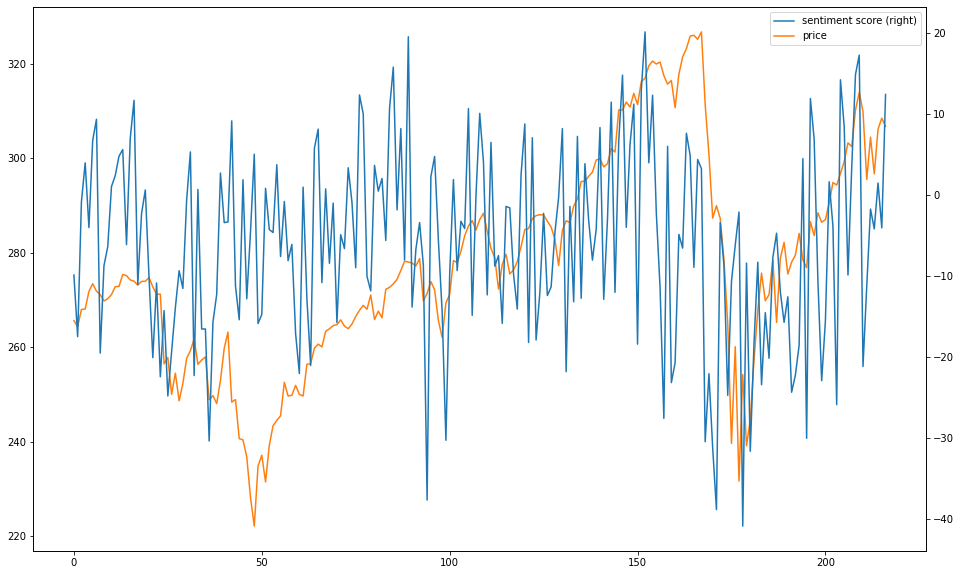

In [7]:
df.plot(secondary_y='sentiment score', figsize=(16, 10));

<ipython-input-8-33074a9c91ea>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['fourier '+str(num_)]=np.fft.ifft(fft_list_m10)
C:\Users\amanm\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\Users\amanm\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\Users\amanm\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\Users\amanm\anaconda3\lib\site-pa

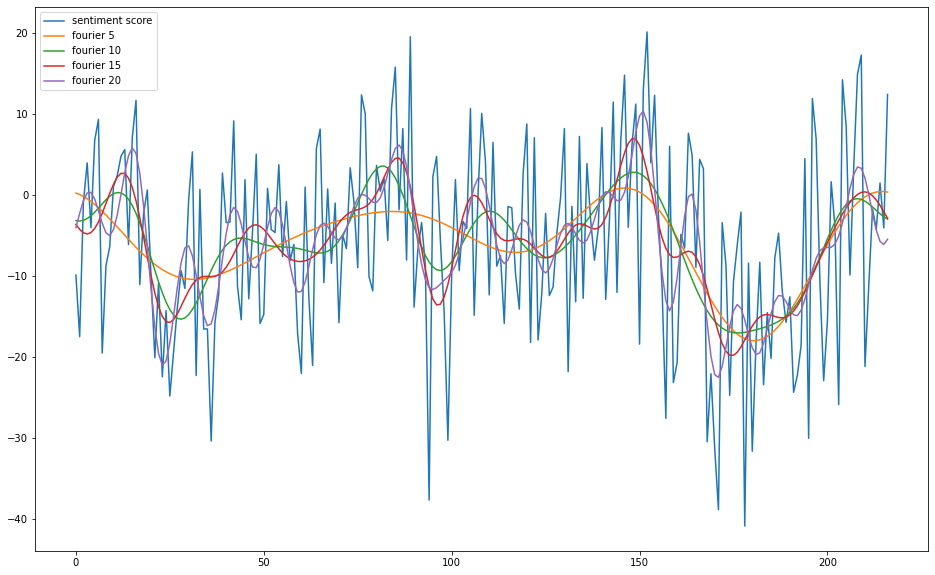

In [8]:
## fourier transform

close_fft = np.fft.fft(np.asarray(df['sentiment score'].tolist()))
fft_df = pd.DataFrame({'fft':close_fft})
fft_df['absolute'] = fft_df['fft'].apply(lambda x: np.abs(x))
fft_df['angle'] = fft_df['fft'].apply(lambda x: np.angle(x))
fft_list = np.asarray(fft_df['fft'].tolist())

for num_ in [5, 10, 15, 20]:
    fft_list_m10= np.copy(fft_list); fft_list_m10[num_:-num_]=0
    df['fourier '+str(num_)]=np.fft.ifft(fft_list_m10)
    
df[['sentiment score', 'fourier 5', 'fourier 10', 'fourier 15', 'fourier 20']].plot(figsize=(16, 10));

C:\Users\amanm\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


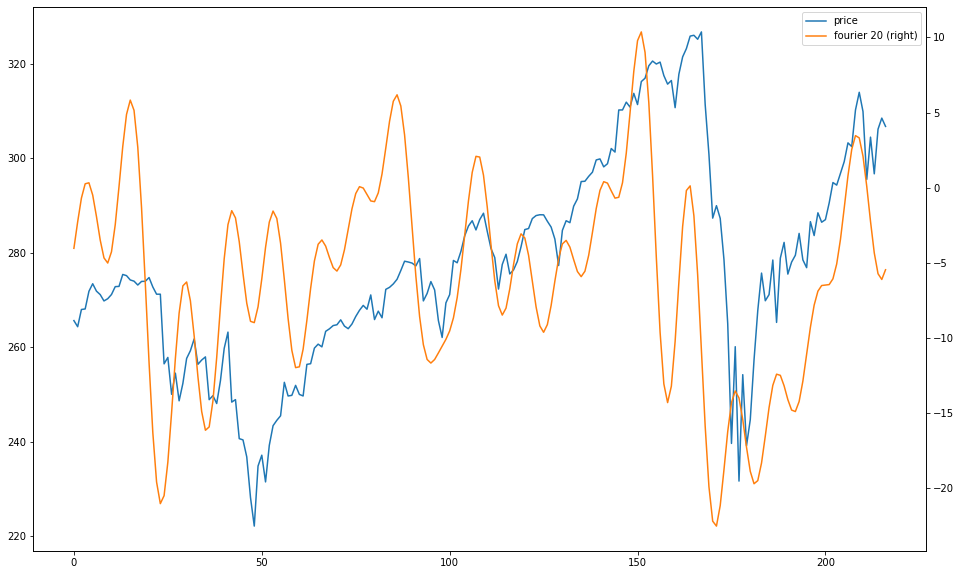

In [9]:
df[['price', 'fourier 20']].plot(secondary_y='fourier 20', figsize=(16, 10));

<ipython-input-14-d6370f2bf206>:7: ComplexWarning: Casting complex values to real discards the imaginary part
  df['norm_fourier5']=sc.fit_transform(np.asarray(list([(float(x)) for x in df['fourier 5'].to_numpy()])).reshape(-1, 1))
<ipython-input-14-d6370f2bf206>:8: ComplexWarning: Casting complex values to real discards the imaginary part
  df['norm_fourier10']=sc.fit_transform(np.asarray(list([(float(x)) for x in df['fourier 10'].to_numpy()])).reshape(-1, 1))
<ipython-input-14-d6370f2bf206>:9: ComplexWarning: Casting complex values to real discards the imaginary part
  df['norm_fourier15']=sc.fit_transform(np.asarray(list([(float(x)) for x in df['fourier 15'].to_numpy()])).reshape(-1, 1))
<ipython-input-14-d6370f2bf206>:10: ComplexWarning: Casting complex values to real discards the imaginary part
  df['norm_fourier20']=sc.fit_transform(np.asarray(list([(float(x)) for x in df['fourier 20'].to_numpy()])).reshape(-1, 1))


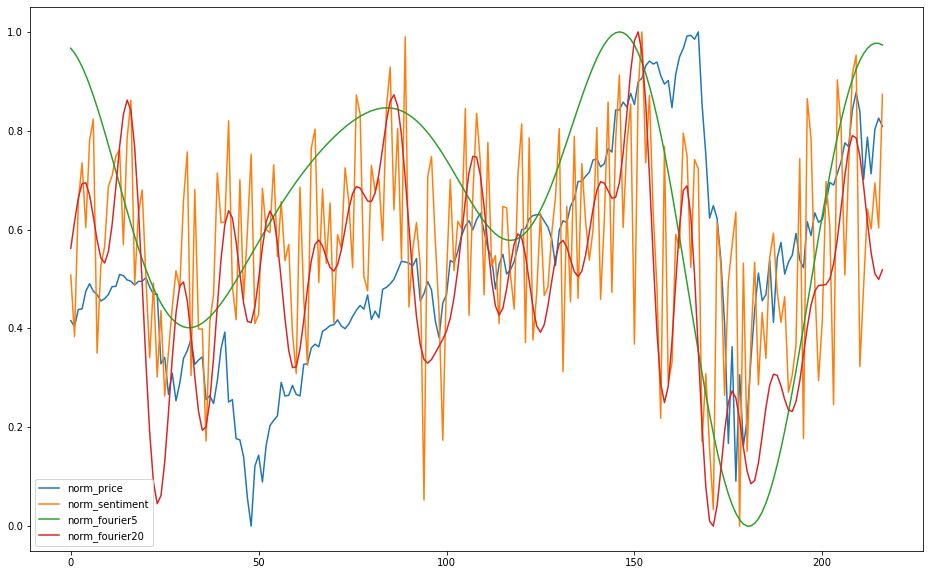

In [14]:
#normalize
from sklearn.preprocessing import MinMaxScaler
sc= MinMaxScaler(feature_range=(0,1))
df['norm_price']=sc.fit_transform(df['price'].to_numpy().reshape(-1, 1))
df['price log']=np.log(df['price']/df['price'].shift(1))
df['norm_sentiment']=sc.fit_transform(df['sentiment score'].to_numpy().reshape(-1, 1))
df['norm_fourier5']=sc.fit_transform(np.asarray(list([(float(x)) for x in df['fourier 5'].to_numpy()])).reshape(-1, 1))
df['norm_fourier10']=sc.fit_transform(np.asarray(list([(float(x)) for x in df['fourier 10'].to_numpy()])).reshape(-1, 1))
df['norm_fourier15']=sc.fit_transform(np.asarray(list([(float(x)) for x in df['fourier 15'].to_numpy()])).reshape(-1, 1))
df['norm_fourier20']=sc.fit_transform(np.asarray(list([(float(x)) for x in df['fourier 20'].to_numpy()])).reshape(-1, 1))

df[['norm_price', 'norm_sentiment', 'norm_fourier5', 'norm_fourier20']].plot(figsize=(16, 10));

In [15]:
# df.to_csv('all_data.csv')

In [101]:
def getPushshiftData(query, after, before, sub):
    url = 'https://api.pushshift.io/reddit/search/submission/?title='+str(query)+'&size=1000&after='+str(after)+'&before='+str(before)+'&subreddit='+str(sub)
    print(url)
    
    r = requests.get(url)
    data = json.loads(r.text)
    
    return data['data']

def collectSubData(subm):
    subData = [subm['id'], subm['title'], subm['url'], datetime.datetime.fromtimestamp(subm['created_utc']).date()]
    try:
        flair = subm['link_flair_text']
    except KeyError:
        flair = "NaN"
    subData.append(flair)
    subStats.append(subData)
    
#Subreddit to query
sub='wallstreetbets'
#before and after dates
before = "1594339200" #july 10 2020
after = "1498867200" #july 1 2017
query = ""
subCount = 0
subStats = []

data = getPushshiftData(query, after, before, sub)
# Will run until all posts have been gathered 
# from the 'after' date up until before date
while len(data) > 0:
    for submission in data:
        collectSubData(submission)
        subCount+=1
    # Calls getPushshiftData() with the created date of the last submission
    print(len(data))
    print(str(datetime.datetime.fromtimestamp(data[-1]['created_utc'])))
    after = data[-1]['created_utc']
    try:
        data = getPushshiftData(query, after, before, sub)
    except:
        pass
      
data={}
ids=[]
titles=[]
urls=[]
dates=[]
flairs=[]
for stat in subStats:
    ids.append(stat[0])
    titles.append(stat[1])
    urls.append(stat[2])
    dates.append(stat[3])
    flairs.append(stat[4])
data['id']=ids
data['title']=titles
data['url']=urls
data['date']=dates
data['flair']=flairs


https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1498867200&before=1594339200&subreddit=wallstreetbets
100
2017-07-02 22:16:47
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1499048207&before=1594339200&subreddit=wallstreetbets
100
2017-07-03 19:02:57
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1499122977&before=1594339200&subreddit=wallstreetbets
100
2017-07-05 09:35:34
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1499261734&before=1594339200&subreddit=wallstreetbets
99
2017-07-05 18:50:41
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1499295041&before=1594339200&subreddit=wallstreetbets
100
2017-07-06 15:20:27
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1499368827&before=1594339200&subreddit=wallstreetbets
100
2017-07-07 11:48:05
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1499442485&befo

100
2017-08-11 19:14:23
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1502493263&before=1594339200&subreddit=wallstreetbets
100
2017-08-13 23:37:35
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1502681855&before=1594339200&subreddit=wallstreetbets
100
2017-08-14 17:47:14
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1502747234&before=1594339200&subreddit=wallstreetbets
100
2017-08-15 14:16:50
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1502821010&before=1594339200&subreddit=wallstreetbets
100
2017-08-16 11:22:47
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1502896967&before=1594339200&subreddit=wallstreetbets
100
2017-08-17 10:46:01
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1502981161&before=1594339200&subreddit=wallstreetbets
100
2017-08-18 03:31:14
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2017-10-10 09:42:37
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1507642957&before=1594339200&subreddit=wallstreetbets
100
2017-10-10 17:24:57
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1507670697&before=1594339200&subreddit=wallstreetbets
100
2017-10-11 13:04:17
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1507741457&before=1594339200&subreddit=wallstreetbets
100
2017-10-11 21:40:50
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1507772450&before=1594339200&subreddit=wallstreetbets
100
2017-10-12 12:47:45
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1507826865&before=1594339200&subreddit=wallstreetbets
100
2017-10-12 19:40:37
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1507851637&before=1594339200&subreddit=wallstreetbets
100
2017-10-13 11:30:08
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2017-11-23 10:25:30
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1511450730&before=1594339200&subreddit=wallstreetbets
100
2017-11-24 17:51:53
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1511563913&before=1594339200&subreddit=wallstreetbets
100
2017-11-26 13:30:17
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1511721017&before=1594339200&subreddit=wallstreetbets
100
2017-11-27 12:51:57
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1511805117&before=1594339200&subreddit=wallstreetbets
99
2017-11-28 06:23:53
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1511868233&before=1594339200&subreddit=wallstreetbets
99
2017-11-28 18:24:48
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1511911488&before=1594339200&subreddit=wallstreetbets
99
2017-11-29 10:34:14
https://api.pushshift.io/reddit/search/submission/?title=&size=1000

99
2018-01-18 15:51:35
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1516308695&before=1594339200&subreddit=wallstreetbets
100
2018-01-19 11:48:30
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1516380510&before=1594339200&subreddit=wallstreetbets
99
2018-01-20 14:59:04
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1516478344&before=1594339200&subreddit=wallstreetbets
100
2018-01-22 10:36:20
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1516635380&before=1594339200&subreddit=wallstreetbets
98
2018-01-22 19:38:07
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1516667887&before=1594339200&subreddit=wallstreetbets
100
2018-01-23 14:32:38
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1516735958&before=1594339200&subreddit=wallstreetbets
99
2018-01-24 07:36:11
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&

99
2018-02-14 19:51:34
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1518655894&before=1594339200&subreddit=wallstreetbets
99
2018-02-14 19:51:34
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1518655894&before=1594339200&subreddit=wallstreetbets
100
2018-02-15 12:11:30
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1518714690&before=1594339200&subreddit=wallstreetbets
100
2018-02-15 12:11:30
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1518714690&before=1594339200&subreddit=wallstreetbets
100
2018-02-15 12:11:30
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1518714690&before=1594339200&subreddit=wallstreetbets
99
2018-02-15 21:42:39
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1518748959&before=1594339200&subreddit=wallstreetbets
100
2018-02-16 13:02:58
https://api.pushshift.io/reddit/search/submission/?title=&size=1000

100
2018-03-17 05:19:38
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1521278378&before=1594339200&subreddit=wallstreetbets
100
2018-03-19 08:02:19
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1521460939&before=1594339200&subreddit=wallstreetbets
97
2018-03-19 16:46:34
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1521492394&before=1594339200&subreddit=wallstreetbets
100
2018-03-20 11:53:40
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1521561220&before=1594339200&subreddit=wallstreetbets
100
2018-03-20 22:38:49
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1521599929&before=1594339200&subreddit=wallstreetbets
100
2018-03-21 13:06:18
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1521651978&before=1594339200&subreddit=wallstreetbets
99
2018-03-22 01:13:38
https://api.pushshift.io/reddit/search/submission/?title=&size=100

100
2018-04-23 10:30:36
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1524493836&before=1594339200&subreddit=wallstreetbets
100
2018-04-24 07:23:35
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1524569015&before=1594339200&subreddit=wallstreetbets
99
2018-04-24 15:33:48
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1524598428&before=1594339200&subreddit=wallstreetbets
100
2018-04-25 10:04:37
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1524665077&before=1594339200&subreddit=wallstreetbets
99
2018-04-25 16:28:48
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1524688128&before=1594339200&subreddit=wallstreetbets
99
2018-04-26 08:46:38
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1524746798&before=1594339200&subreddit=wallstreetbets
99
2018-04-26 16:10:43
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&

100
2018-05-27 13:19:25
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1527441565&before=1594339200&subreddit=wallstreetbets
100
2018-05-28 21:46:58
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1527558418&before=1594339200&subreddit=wallstreetbets
100
2018-05-29 13:56:06
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1527616566&before=1594339200&subreddit=wallstreetbets
100
2018-05-30 01:18:57
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1527657537&before=1594339200&subreddit=wallstreetbets
100
2018-05-30 13:20:12
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1527700812&before=1594339200&subreddit=wallstreetbets
100
2018-05-31 01:09:59
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1527743399&before=1594339200&subreddit=wallstreetbets
100
2018-05-31 12:20:06
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2018-06-21 18:20:32
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1529619632&before=1594339200&subreddit=wallstreetbets
100
2018-06-22 08:10:01
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1529669401&before=1594339200&subreddit=wallstreetbets
100
2018-06-22 12:14:47
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1529684087&before=1594339200&subreddit=wallstreetbets
100
2018-06-22 17:55:49
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1529704549&before=1594339200&subreddit=wallstreetbets
100
2018-06-23 14:01:45
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1529776905&before=1594339200&subreddit=wallstreetbets
100
2018-06-24 13:59:25
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1529863165&before=1594339200&subreddit=wallstreetbets
100
2018-06-25 07:31:46
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2018-07-19 18:03:22
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1532037802&before=1594339200&subreddit=wallstreetbets
100
2018-07-20 09:02:07
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1532091727&before=1594339200&subreddit=wallstreetbets
100
2018-07-20 15:03:29
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1532113409&before=1594339200&subreddit=wallstreetbets
100
2018-07-21 18:29:31
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1532212171&before=1594339200&subreddit=wallstreetbets
100
2018-07-22 21:15:25
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1532308525&before=1594339200&subreddit=wallstreetbets
100
2018-07-23 12:08:34
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1532362114&before=1594339200&subreddit=wallstreetbets
100
2018-07-23 19:49:49
https://api.pushshift.io/reddit/search/submission/?title=&size=1

99
2018-08-09 16:55:19
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1533848119&before=1594339200&subreddit=wallstreetbets
95
2018-08-10 03:35:21
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1533886521&before=1594339200&subreddit=wallstreetbets
64
2018-08-10 10:07:30
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1533910050&before=1594339200&subreddit=wallstreetbets
67
2018-08-10 12:37:38
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1533919058&before=1594339200&subreddit=wallstreetbets
66
2018-08-10 15:59:40
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1533931180&before=1594339200&subreddit=wallstreetbets
72
2018-08-10 22:41:27
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1533955287&before=1594339200&subreddit=wallstreetbets
65
2018-08-11 14:28:35
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&aft

100
2018-09-02 21:59:54
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1535939994&before=1594339200&subreddit=wallstreetbets
100
2018-09-03 17:08:35
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1536008915&before=1594339200&subreddit=wallstreetbets
99
2018-09-04 09:30:53
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1536067853&before=1594339200&subreddit=wallstreetbets
100
2018-09-04 14:12:32
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1536084752&before=1594339200&subreddit=wallstreetbets
99
2018-09-04 19:46:19
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1536104779&before=1594339200&subreddit=wallstreetbets
100
2018-09-05 09:15:28
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1536153328&before=1594339200&subreddit=wallstreetbets
100
2018-09-05 11:14:45
https://api.pushshift.io/reddit/search/submission/?title=&size=100

100
2018-09-24 11:54:27
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1537804467&before=1594339200&subreddit=wallstreetbets
100
2018-09-24 19:01:14
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1537830074&before=1594339200&subreddit=wallstreetbets
100
2018-09-25 11:15:58
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1537888558&before=1594339200&subreddit=wallstreetbets
100
2018-09-25 16:23:00
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1537906980&before=1594339200&subreddit=wallstreetbets
99
2018-09-26 02:12:01
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1537942321&before=1594339200&subreddit=wallstreetbets
100
2018-09-26 13:04:49
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1537981489&before=1594339200&subreddit=wallstreetbets
99
2018-09-26 19:04:44
https://api.pushshift.io/reddit/search/submission/?title=&size=100

100
2018-10-15 19:25:41
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1539645941&before=1594339200&subreddit=wallstreetbets
100
2018-10-16 11:32:00
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1539703920&before=1594339200&subreddit=wallstreetbets
99
2018-10-16 17:36:23
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1539725783&before=1594339200&subreddit=wallstreetbets
100
2018-10-17 07:38:49
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1539776329&before=1594339200&subreddit=wallstreetbets
99
2018-10-17 15:46:15
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1539805575&before=1594339200&subreddit=wallstreetbets
100
2018-10-18 03:20:48
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1539847248&before=1594339200&subreddit=wallstreetbets
99
2018-10-18 14:15:08
https://api.pushshift.io/reddit/search/submission/?title=&size=1000

100
2018-11-13 22:07:04
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1542164824&before=1594339200&subreddit=wallstreetbets
98
2018-11-14 13:46:40
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1542221200&before=1594339200&subreddit=wallstreetbets
98
2018-11-15 03:49:05
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1542271745&before=1594339200&subreddit=wallstreetbets
99
2018-11-15 14:08:07
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1542308887&before=1594339200&subreddit=wallstreetbets
100
2018-11-15 21:54:03
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1542336843&before=1594339200&subreddit=wallstreetbets
99
2018-11-16 13:51:42
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1542394302&before=1594339200&subreddit=wallstreetbets
100
2018-11-17 11:06:59
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&

100
2018-12-20 09:38:08
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1545316688&before=1594339200&subreddit=wallstreetbets
100
2018-12-20 15:57:30
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1545339450&before=1594339200&subreddit=wallstreetbets
100
2018-12-21 06:51:23
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1545393083&before=1594339200&subreddit=wallstreetbets
100
2018-12-21 14:05:10
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1545419110&before=1594339200&subreddit=wallstreetbets
100
2018-12-21 18:17:18
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1545434238&before=1594339200&subreddit=wallstreetbets
100
2018-12-22 09:38:56
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1545489536&before=1594339200&subreddit=wallstreetbets
100
2018-12-23 00:51:16
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2019-01-23 21:36:26
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1548297386&before=1594339200&subreddit=wallstreetbets
100
2019-01-24 15:28:50
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1548361730&before=1594339200&subreddit=wallstreetbets
100
2019-01-25 01:46:40
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1548398800&before=1594339200&subreddit=wallstreetbets
100
2019-01-25 18:34:43
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1548459283&before=1594339200&subreddit=wallstreetbets
100
2019-01-27 00:44:31
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1548567871&before=1594339200&subreddit=wallstreetbets
100
2019-01-28 09:41:31
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1548686491&before=1594339200&subreddit=wallstreetbets
100
2019-01-28 19:31:07
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2019-03-08 13:29:10
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1552069750&before=1594339200&subreddit=wallstreetbets
100
2019-03-09 18:16:05
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1552173365&before=1594339200&subreddit=wallstreetbets
100
2019-03-11 01:53:58
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1552283638&before=1594339200&subreddit=wallstreetbets
100
2019-03-11 17:06:15
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1552338375&before=1594339200&subreddit=wallstreetbets
100
2019-03-12 13:07:46
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1552410466&before=1594339200&subreddit=wallstreetbets
100
2019-03-13 04:51:21
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1552467081&before=1594339200&subreddit=wallstreetbets
100
2019-03-13 17:48:46
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2019-04-20 19:39:50
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1555803590&before=1594339200&subreddit=wallstreetbets
100
2019-04-22 09:38:44
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1555940324&before=1594339200&subreddit=wallstreetbets
100
2019-04-22 23:13:20
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1555989200&before=1594339200&subreddit=wallstreetbets
100
2019-04-23 14:29:08
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1556044148&before=1594339200&subreddit=wallstreetbets
100
2019-04-23 22:41:33
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1556073693&before=1594339200&subreddit=wallstreetbets
100
2019-04-24 14:08:54
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1556129334&before=1594339200&subreddit=wallstreetbets
100
2019-04-25 00:22:09
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2019-05-24 16:56:10
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1558731370&before=1594339200&subreddit=wallstreetbets
100
2019-05-26 21:00:17
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1558918817&before=1594339200&subreddit=wallstreetbets
100
2019-05-28 14:25:43
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1559067943&before=1594339200&subreddit=wallstreetbets
99
2019-05-29 12:02:18
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1559145738&before=1594339200&subreddit=wallstreetbets
98
2019-05-30 13:07:05
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1559236025&before=1594339200&subreddit=wallstreetbets
100
2019-05-31 01:01:50
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1559278910&before=1594339200&subreddit=wallstreetbets
100
2019-05-31 15:34:05
https://api.pushshift.io/reddit/search/submission/?title=&size=100

100
2019-07-09 13:31:06
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1562693466&before=1594339200&subreddit=wallstreetbets
100
2019-07-10 03:06:42
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1562742402&before=1594339200&subreddit=wallstreetbets
100
2019-07-10 15:35:07
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1562787307&before=1594339200&subreddit=wallstreetbets
100
2019-07-11 09:42:47
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1562852567&before=1594339200&subreddit=wallstreetbets
100
2019-07-11 22:01:40
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1562896900&before=1594339200&subreddit=wallstreetbets
100
2019-07-12 16:23:24
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1562963004&before=1594339200&subreddit=wallstreetbets
100
2019-07-13 23:41:31
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2019-08-10 12:34:32
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1565454872&before=1594339200&subreddit=wallstreetbets
100
2019-08-11 16:29:51
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1565555391&before=1594339200&subreddit=wallstreetbets
100
2019-08-12 12:14:31
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1565626471&before=1594339200&subreddit=wallstreetbets
100
2019-08-12 21:03:13
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1565658193&before=1594339200&subreddit=wallstreetbets
100
2019-08-13 10:32:55
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1565706775&before=1594339200&subreddit=wallstreetbets
100
2019-08-13 16:30:26
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1565728226&before=1594339200&subreddit=wallstreetbets
100
2019-08-14 05:55:02
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2019-09-06 23:07:37
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1567825657&before=1594339200&subreddit=wallstreetbets
100
2019-09-08 08:33:30
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1567946010&before=1594339200&subreddit=wallstreetbets
100
2019-09-09 10:16:14
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1568038574&before=1594339200&subreddit=wallstreetbets
100
2019-09-09 19:10:53
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1568070653&before=1594339200&subreddit=wallstreetbets
100
2019-09-10 13:13:07
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1568135587&before=1594339200&subreddit=wallstreetbets
100
2019-09-10 22:47:20
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1568170040&before=1594339200&subreddit=wallstreetbets
100
2019-09-11 13:15:37
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2019-10-17 02:38:08
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1571294288&before=1594339200&subreddit=wallstreetbets
100
2019-10-17 15:50:02
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1571341802&before=1594339200&subreddit=wallstreetbets
99
2019-10-18 09:52:42
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1571406762&before=1594339200&subreddit=wallstreetbets
100
2019-10-18 22:47:49
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1571453269&before=1594339200&subreddit=wallstreetbets
100
2019-10-20 02:28:20
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1571552900&before=1594339200&subreddit=wallstreetbets
100
2019-10-21 10:14:40
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1571667280&before=1594339200&subreddit=wallstreetbets
100
2019-10-21 23:11:39
https://api.pushshift.io/reddit/search/submission/?title=&size=10

100
2019-11-15 08:10:26
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1573823426&before=1594339200&subreddit=wallstreetbets
100
2019-11-15 15:11:35
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1573848695&before=1594339200&subreddit=wallstreetbets
100
2019-11-16 06:23:47
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1573903427&before=1594339200&subreddit=wallstreetbets
100
2019-11-17 07:47:15
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1573994835&before=1594339200&subreddit=wallstreetbets
100
2019-11-18 02:22:42
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1574061762&before=1594339200&subreddit=wallstreetbets
100
2019-11-18 17:30:44
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1574116244&before=1594339200&subreddit=wallstreetbets
100
2019-11-19 09:52:00
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2019-12-18 10:42:00
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1576683720&before=1594339200&subreddit=wallstreetbets
100
2019-12-18 20:46:55
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1576720015&before=1594339200&subreddit=wallstreetbets
100
2019-12-19 13:16:56
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1576779416&before=1594339200&subreddit=wallstreetbets
100
2019-12-19 23:52:05
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1576817525&before=1594339200&subreddit=wallstreetbets
100
2019-12-20 14:49:57
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1576871397&before=1594339200&subreddit=wallstreetbets
100
2019-12-21 12:53:32
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1576950812&before=1594339200&subreddit=wallstreetbets
100
2019-12-22 19:00:04
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2020-01-16 10:28:57
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1579188537&before=1594339200&subreddit=wallstreetbets
100
2020-01-16 15:32:49
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1579206769&before=1594339200&subreddit=wallstreetbets
99
2020-01-16 21:33:35
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1579228415&before=1594339200&subreddit=wallstreetbets
100
2020-01-17 09:10:31
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1579270231&before=1594339200&subreddit=wallstreetbets
100
2020-01-17 14:21:29
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1579288889&before=1594339200&subreddit=wallstreetbets
100
2020-01-17 21:14:22
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1579313662&before=1594339200&subreddit=wallstreetbets
100
2020-01-18 12:25:39
https://api.pushshift.io/reddit/search/submission/?title=&size=10

100
2020-02-02 17:55:45
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1580684145&before=1594339200&subreddit=wallstreetbets
100
2020-02-03 00:55:08
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1580709308&before=1594339200&subreddit=wallstreetbets
100
2020-02-03 10:16:45
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1580743005&before=1594339200&subreddit=wallstreetbets
100
2020-02-03 12:42:43
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1580751763&before=1594339200&subreddit=wallstreetbets
100
2020-02-03 15:18:16
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1580761096&before=1594339200&subreddit=wallstreetbets
100
2020-02-03 17:49:51
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1580770191&before=1594339200&subreddit=wallstreetbets
100
2020-02-03 21:28:23
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2020-02-11 08:46:02
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1581428762&before=1594339200&subreddit=wallstreetbets
100
2020-02-11 10:55:38
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1581436538&before=1594339200&subreddit=wallstreetbets
100
2020-02-11 12:50:01
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1581443401&before=1594339200&subreddit=wallstreetbets
100
2020-02-11 14:39:09
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1581449949&before=1594339200&subreddit=wallstreetbets
100
2020-02-11 16:40:27
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1581457227&before=1594339200&subreddit=wallstreetbets
100
2020-02-11 19:45:03
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1581468303&before=1594339200&subreddit=wallstreetbets
100
2020-02-11 22:29:31
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2020-02-20 00:00:18
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1582174818&before=1594339200&subreddit=wallstreetbets
100
2020-02-20 06:48:29
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1582199309&before=1594339200&subreddit=wallstreetbets
100
2020-02-20 09:54:49
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1582210489&before=1594339200&subreddit=wallstreetbets
100
2020-02-20 11:03:17
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1582214597&before=1594339200&subreddit=wallstreetbets
100
2020-02-20 11:42:20
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1582216940&before=1594339200&subreddit=wallstreetbets
100
2020-02-20 12:31:38
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1582219898&before=1594339200&subreddit=wallstreetbets
100
2020-02-20 13:26:25
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2020-02-26 13:30:25
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1582741825&before=1594339200&subreddit=wallstreetbets
100
2020-02-26 14:54:22
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1582746862&before=1594339200&subreddit=wallstreetbets
100
2020-02-26 16:10:25
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1582751425&before=1594339200&subreddit=wallstreetbets
100
2020-02-26 17:14:23
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1582755263&before=1594339200&subreddit=wallstreetbets
100
2020-02-26 18:37:09
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1582760229&before=1594339200&subreddit=wallstreetbets
100
2020-02-26 20:04:23
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1582765463&before=1594339200&subreddit=wallstreetbets
100
2020-02-26 21:44:45
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2020-03-01 20:30:05
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1583112605&before=1594339200&subreddit=wallstreetbets
100
2020-03-01 22:28:07
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1583119687&before=1594339200&subreddit=wallstreetbets
100
2020-03-02 01:32:17
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1583130737&before=1594339200&subreddit=wallstreetbets
100
2020-03-02 07:27:27
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1583152047&before=1594339200&subreddit=wallstreetbets
100
2020-03-02 09:54:05
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1583160845&before=1594339200&subreddit=wallstreetbets
100
2020-03-02 10:41:02
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1583163662&before=1594339200&subreddit=wallstreetbets
100
2020-03-02 11:35:53
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2020-03-07 01:54:31
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1583564071&before=1594339200&subreddit=wallstreetbets
100
2020-03-07 09:19:44
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1583590784&before=1594339200&subreddit=wallstreetbets
100
2020-03-07 12:33:28
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1583602408&before=1594339200&subreddit=wallstreetbets
100
2020-03-07 15:39:47
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1583613587&before=1594339200&subreddit=wallstreetbets
100
2020-03-07 18:47:31
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1583624851&before=1594339200&subreddit=wallstreetbets
100
2020-03-07 22:18:44
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1583637524&before=1594339200&subreddit=wallstreetbets
100
2020-03-08 06:18:37
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2020-03-11 23:17:15
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1583983035&before=1594339200&subreddit=wallstreetbets
100
2020-03-12 00:39:24
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1583987964&before=1594339200&subreddit=wallstreetbets
100
2020-03-12 03:01:36
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1583996496&before=1594339200&subreddit=wallstreetbets
100
2020-03-12 07:31:04
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584012664&before=1594339200&subreddit=wallstreetbets
100
2020-03-12 09:24:14
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584019454&before=1594339200&subreddit=wallstreetbets
100
2020-03-12 10:03:51
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584021831&before=1594339200&subreddit=wallstreetbets
100
2020-03-12 10:37:31
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2020-03-15 02:50:25
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584255025&before=1594339200&subreddit=wallstreetbets
100
2020-03-15 09:32:00
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584279120&before=1594339200&subreddit=wallstreetbets
100
2020-03-15 12:29:38
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584289778&before=1594339200&subreddit=wallstreetbets
100
2020-03-15 14:41:40
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584297700&before=1594339200&subreddit=wallstreetbets
100
2020-03-15 16:26:05
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584303965&before=1594339200&subreddit=wallstreetbets
100
2020-03-15 17:34:29
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584308069&before=1594339200&subreddit=wallstreetbets
100
2020-03-15 18:18:48
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2020-03-18 06:14:43
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584526483&before=1594339200&subreddit=wallstreetbets
100
2020-03-18 09:18:40
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584537520&before=1594339200&subreddit=wallstreetbets
100
2020-03-18 10:22:59
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584541379&before=1594339200&subreddit=wallstreetbets
100
2020-03-18 11:22:55
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584544975&before=1594339200&subreddit=wallstreetbets
100
2020-03-18 12:21:14
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584548474&before=1594339200&subreddit=wallstreetbets
100
2020-03-18 12:59:55
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584550795&before=1594339200&subreddit=wallstreetbets
100
2020-03-18 13:23:55
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2020-03-22 16:53:04
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584910384&before=1594339200&subreddit=wallstreetbets
100
2020-03-22 18:47:56
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584917276&before=1594339200&subreddit=wallstreetbets
100
2020-03-22 20:27:30
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584923250&before=1594339200&subreddit=wallstreetbets
100
2020-03-22 22:26:13
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584930373&before=1594339200&subreddit=wallstreetbets
100
2020-03-23 01:24:53
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584941093&before=1594339200&subreddit=wallstreetbets
99
2020-03-23 07:24:11
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1584962651&before=1594339200&subreddit=wallstreetbets
100
2020-03-23 09:09:05
https://api.pushshift.io/reddit/search/submission/?title=&size=10

100
2020-03-26 19:32:52
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1585265572&before=1594339200&subreddit=wallstreetbets
100
2020-03-26 21:15:05
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1585271705&before=1594339200&subreddit=wallstreetbets
100
2020-03-26 23:00:39
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1585278039&before=1594339200&subreddit=wallstreetbets
100
2020-03-27 00:42:16
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1585284136&before=1594339200&subreddit=wallstreetbets
100
2020-03-27 05:12:57
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1585300377&before=1594339200&subreddit=wallstreetbets
100
2020-03-27 09:08:27
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1585314507&before=1594339200&subreddit=wallstreetbets
100
2020-03-27 11:21:00
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2020-04-03 01:15:06
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1585890906&before=1594339200&subreddit=wallstreetbets
100
2020-04-03 02:37:28
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1585895848&before=1594339200&subreddit=wallstreetbets
99
2020-04-03 05:00:27
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1585904427&before=1594339200&subreddit=wallstreetbets
100
2020-04-03 08:19:20
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1585916360&before=1594339200&subreddit=wallstreetbets
100
2020-04-03 11:11:38
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1585926698&before=1594339200&subreddit=wallstreetbets
100
2020-04-03 13:40:51
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1585935651&before=1594339200&subreddit=wallstreetbets
100
2020-04-03 16:33:23
https://api.pushshift.io/reddit/search/submission/?title=&size=10

100
2020-04-10 20:33:48
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1586565228&before=1594339200&subreddit=wallstreetbets
100
2020-04-11 00:30:31
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1586579431&before=1594339200&subreddit=wallstreetbets
100
2020-04-11 09:25:07
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1586611507&before=1594339200&subreddit=wallstreetbets
100
2020-04-11 13:43:04
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1586626984&before=1594339200&subreddit=wallstreetbets
100
2020-04-11 17:53:17
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1586641997&before=1594339200&subreddit=wallstreetbets
100
2020-04-11 22:38:37
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1586659117&before=1594339200&subreddit=wallstreetbets
100
2020-04-12 04:06:00
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2020-04-19 03:48:21
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1587282501&before=1594339200&subreddit=wallstreetbets
99
2020-04-19 11:56:24
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1587311784&before=1594339200&subreddit=wallstreetbets
100
2020-04-19 16:04:39
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1587326679&before=1594339200&subreddit=wallstreetbets
100
2020-04-19 20:15:13
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1587341713&before=1594339200&subreddit=wallstreetbets
100
2020-04-20 01:56:57
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1587362217&before=1594339200&subreddit=wallstreetbets
100
2020-04-20 09:37:52
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1587389872&before=1594339200&subreddit=wallstreetbets
100
2020-04-20 11:57:20
https://api.pushshift.io/reddit/search/submission/?title=&size=10

100
2020-04-27 15:37:13
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1588016233&before=1594339200&subreddit=wallstreetbets
100
2020-04-27 18:27:59
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1588026479&before=1594339200&subreddit=wallstreetbets
100
2020-04-27 22:29:25
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1588040965&before=1594339200&subreddit=wallstreetbets
100
2020-04-28 02:54:30
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1588056870&before=1594339200&subreddit=wallstreetbets
100
2020-04-28 09:54:49
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1588082089&before=1594339200&subreddit=wallstreetbets
100
2020-04-28 12:47:11
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1588092431&before=1594339200&subreddit=wallstreetbets
100
2020-04-28 15:31:28
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2020-05-05 04:54:49
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1588668889&before=1594339200&subreddit=wallstreetbets
100
2020-05-05 11:03:54
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1588691034&before=1594339200&subreddit=wallstreetbets
100
2020-05-05 14:10:28
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1588702228&before=1594339200&subreddit=wallstreetbets
100
2020-05-05 16:49:22
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1588711762&before=1594339200&subreddit=wallstreetbets
100
2020-05-05 20:57:07
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1588726627&before=1594339200&subreddit=wallstreetbets
100
2020-05-06 02:11:03
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1588745463&before=1594339200&subreddit=wallstreetbets
100
2020-05-06 09:46:55
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2020-05-15 15:46:23
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1589571983&before=1594339200&subreddit=wallstreetbets
100
2020-05-15 19:22:31
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1589584951&before=1594339200&subreddit=wallstreetbets
100
2020-05-16 00:57:08
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1589605028&before=1594339200&subreddit=wallstreetbets
100
2020-05-16 13:18:31
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1589649511&before=1594339200&subreddit=wallstreetbets
100
2020-05-16 19:11:31
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1589670691&before=1594339200&subreddit=wallstreetbets
100
2020-05-17 04:44:09
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1589705049&before=1594339200&subreddit=wallstreetbets
100
2020-05-17 15:20:56
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2020-05-27 19:47:01
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1590623221&before=1594339200&subreddit=wallstreetbets
100
2020-05-27 23:41:24
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1590637284&before=1594339200&subreddit=wallstreetbets
100
2020-05-28 06:29:17
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1590661757&before=1594339200&subreddit=wallstreetbets
100
2020-05-28 11:13:12
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1590678792&before=1594339200&subreddit=wallstreetbets
100
2020-05-28 13:28:02
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1590686882&before=1594339200&subreddit=wallstreetbets
100
2020-05-28 16:15:32
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1590696932&before=1594339200&subreddit=wallstreetbets
100
2020-05-28 19:30:41
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2020-06-08 13:36:25
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1591637785&before=1594339200&subreddit=wallstreetbets
100
2020-06-08 15:02:03
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1591642923&before=1594339200&subreddit=wallstreetbets
100
2020-06-08 16:03:03
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1591646583&before=1594339200&subreddit=wallstreetbets
100
2020-06-08 16:46:40
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1591649200&before=1594339200&subreddit=wallstreetbets
100
2020-06-08 17:57:43
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1591653463&before=1594339200&subreddit=wallstreetbets
100
2020-06-08 19:31:15
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1591659075&before=1594339200&subreddit=wallstreetbets
100
2020-06-08 21:15:26
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2020-06-13 21:53:51
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1592099631&before=1594339200&subreddit=wallstreetbets
100
2020-06-14 04:14:04
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1592122444&before=1594339200&subreddit=wallstreetbets
100
2020-06-14 11:56:50
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1592150210&before=1594339200&subreddit=wallstreetbets
100
2020-06-14 16:03:06
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1592164986&before=1594339200&subreddit=wallstreetbets
100
2020-06-14 19:44:57
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1592178297&before=1594339200&subreddit=wallstreetbets
100
2020-06-14 23:54:04
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1592193244&before=1594339200&subreddit=wallstreetbets
100
2020-06-15 04:05:22
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2020-06-23 00:18:18
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1592885898&before=1594339200&subreddit=wallstreetbets
100
2020-06-23 07:50:14
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1592913014&before=1594339200&subreddit=wallstreetbets
100
2020-06-23 11:24:02
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1592925842&before=1594339200&subreddit=wallstreetbets
100
2020-06-23 14:24:51
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1592936691&before=1594339200&subreddit=wallstreetbets
100
2020-06-23 18:23:25
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1592951005&before=1594339200&subreddit=wallstreetbets
100
2020-06-23 23:19:21
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1592968761&before=1594339200&subreddit=wallstreetbets
100
2020-06-24 09:33:51
https://api.pushshift.io/reddit/search/submission/?title=&size=1

100
2020-07-05 08:40:19
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1593952819&before=1594339200&subreddit=wallstreetbets
99
2020-07-05 16:57:41
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1593982661&before=1594339200&subreddit=wallstreetbets
100
2020-07-05 23:32:50
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1594006370&before=1594339200&subreddit=wallstreetbets
100
2020-07-06 09:16:55
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1594041415&before=1594339200&subreddit=wallstreetbets
100
2020-07-06 11:54:43
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1594050883&before=1594339200&subreddit=wallstreetbets
100
2020-07-06 14:43:36
https://api.pushshift.io/reddit/search/submission/?title=&size=1000&after=1594061016&before=1594339200&subreddit=wallstreetbets
100
2020-07-06 17:09:53
https://api.pushshift.io/reddit/search/submission/?title=&size=10

In [ ]:
df_2=pd.DataFrame(data)

In [112]:
## create bull and bear sentiment scores for each day using keywords

titles=df_2['title'].tolist()
titles=list([(title.lower()) for title in titles])

bull_words=['call', 'long', 'all in', 'moon', 'going up', 'rocket', 'buy', 'long term', 'green']
bear_words=['put', 'short', 'going down', 'drop', 'bear', 'sell', 'red']

bull_scores=[]
bear_scores=[]
for title in titles:
    bull=False
    bear=False
    for word in bull_words:
        if word in title:
            bull=True
    if re.findall(r'(\b\d{1,4}[c]\b)|(\b\d{1,4}[ ][c]\b)', title):
            bull=True
            
    for word in bear_words:
        if word in title:
            bear=True
    if re.findall(r'(\b\d{1,4}[p]\b)|(\b\d{1,4}[ ][p]\b)', title):
            bear=True
            
    if bull==True and bear==True:
        bull_scores.append(0)
        bear_scores.append(0)
    if bull==False and bear==False:
        bull_scores.append(0)
        bear_scores.append(0)
    if bull==True and bear==False:
        bull_scores.append(1)
        bear_scores.append(0)
    if bull==False and bear==True:
        bull_scores.append(0)
        bear_scores.append(1)
        
df_2['bull score']=bull_scores
df_2['bear score']=bear_scores

In [113]:
## remove irrelevant flairs

indeces=[]
flairs=df_2['flair'].tolist()
for n in range(len(flairs)):
    if flairs[n]=='DD' or flairs[n]=='Discussion' or flairs[n]=='YOLO' or flairs[n]=='Fundamentals' or flairs[n]=='Stocks':
        indeces.append(n)
df_2=df_2.iloc[indeces]

In [133]:
## standardize scores using total scores for day

scores_df=df_2.groupby('date').sum()
scores_df['bull score']=scores_df['bull score']/df_2.groupby('date').count()['bull score']
scores_df['bear score']=scores_df['bear score']/df_2.groupby('date').count()['bear score']

In [11]:
# df_2.to_csv("df_2.csv")
df_2 = pd.read_csv("df_2.csv")
scores_df = pd.read_csv("scores_df.csv")

In [12]:
scores_df

,Unnamed: 0,date,bull score,bear score
0,0,2017-07-01,0.000000,0.000000
1,1,2017-07-02,0.500000,0.250000
2,2,2017-07-03,0.333333,0.000000
3,3,2017-07-04,0.000000,0.250000
4,4,2017-07-05,0.400000,0.000000
...,...,...,...,...
1083,1083,2020-07-05,0.133929,0.062500
1084,1084,2020-07-06,0.147410,0.107570
1085,1085,2020-07-07,0.156780,0.080508
1086,1086,2020-07-08,0.115741,0.092593


In [13]:
## merge with spy price and plot

df_spy=ffn.get('spy', start='2017-07-01')
df_spy=df_spy.loc[:'2020-07-09']
scores_df.to_csv('scores_df.csv')
df_spy.head(5)

,spy
Date,
2017-07-03,223.036316
2017-07-05,223.552017
2017-07-06,221.507721
2017-07-07,222.944229
2017-07-10,223.183670


In [184]:
# df_spy.to_csv("df_spy.csv")

In [14]:
df_spy = pd.read_csv("df_spy.csv")
df_spy

,date,spy
0,2017-07-03,223.036331
1,2017-07-05,223.551987
2,2017-07-06,221.507736
3,2017-07-07,222.944214
4,2017-07-10,223.183655
...,...,...
755,2020-07-02,304.645264
756,2020-07-06,309.348144
757,2020-07-07,306.157593
758,2020-07-08,308.499268


In [197]:
# scores_df.to_csv('scores_df.csv')

In [15]:
scores_df = pd.read_csv('scores_df.csv')
scores_df

,Unnamed: 0,Unnamed: 0.1,date,bull score,bear score
0,0,0,2017-07-01,0.000000,0.000000
1,1,1,2017-07-02,0.500000,0.250000
2,2,2,2017-07-03,0.333333,0.000000
3,3,3,2017-07-04,0.000000,0.250000
4,4,4,2017-07-05,0.400000,0.000000
...,...,...,...,...,...
1083,1083,1083,2020-07-05,0.133929,0.062500
1084,1084,1084,2020-07-06,0.147410,0.107570
1085,1085,1085,2020-07-07,0.156780,0.080508
1086,1086,1086,2020-07-08,0.115741,0.092593


In [16]:
for date in df_spy['date']:
    for dates in scores_df["date"]:
        print(date)

2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03
2017-07-03

2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05
2017-07-05

2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07
2017-07-07

2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-10
2017-07-11
2017-07-11
2017-07-11
2017-07-11
2017-07-11
2017-07-11
2017-07-11
2017-07-11
2017-07-11
2017-07-11
2017-07-11
2017-07-11
2017-07-11

2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12
2017-07-12

2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14
2017-07-14

2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18
2017-07-18

2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20
2017-07-20

2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21
2017-07-21

2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24
2017-07-24

2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-25
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26
2017-07-26

2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27
2017-07-27

2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31
2017-07-31

2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-02
2017-08-03
2017-08-03
2017-08-03
2017-08-03
2017-08-03
2017-08-03
2017-08-03
2017-08-03
2017-08-03
2017-08-03
2017-08-03
2017-08-03

2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07
2017-08-07

2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09
2017-08-09

2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11
2017-08-11

2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14
2017-08-14

2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16
2017-08-16

2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18
2017-08-18

2017-08-21
2017-08-21
2017-08-21
2017-08-21
2017-08-21
2017-08-21
2017-08-21
2017-08-21
2017-08-21
2017-08-21
2017-08-21
2017-08-21
2017-08-21
2017-08-21
2017-08-21
2017-08-21
2017-08-21
2017-08-21
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22
2017-08-22

2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23
2017-08-23

2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25
2017-08-25

2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28
2017-08-28

2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30
2017-08-30

2017-09-01
2017-09-01
2017-09-01
2017-09-01
2017-09-01
2017-09-01
2017-09-01
2017-09-01
2017-09-01
2017-09-01
2017-09-01
2017-09-01
2017-09-01
2017-09-01
2017-09-01
2017-09-01
2017-09-01
2017-09-01
2017-09-01
2017-09-01
2017-09-01
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05
2017-09-05

2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07
2017-09-07

2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08
2017-09-08

2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11
2017-09-11

2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12

2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-12
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13

2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13
2017-09-13

2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-15
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18
2017-09-18

2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20
2017-09-20

2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22
2017-09-22

2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26
2017-09-26

2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28
2017-09-28

2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02
2017-10-02

2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03
2017-10-03

2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-05
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06
2017-10-06

2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10
2017-10-10

2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12
2017-10-12

2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16
2017-10-16

2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18
2017-10-18

2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20
2017-10-20

2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24
2017-10-24

2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26
2017-10-26

2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30
2017-10-30

2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31
2017-10-31

2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03
2017-11-03

2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07
2017-11-07

2017-11-08
2017-11-08
2017-11-08
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09
2017-11-09

2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10
2017-11-10

2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-14
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15
2017-11-15

2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-16
2017-11-17
2017-11-17

2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20
2017-11-20

2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-22
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24
2017-11-24

2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27
2017-11-27

2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29
2017-11-29

2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01
2017-12-01

2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05
2017-12-05

2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07
2017-12-07

2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11
2017-12-11

2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13
2017-12-13

2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15
2017-12-15

2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-18
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19
2017-12-19

2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20
2017-12-20

2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22
2017-12-22

2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27
2017-12-27

2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29
2017-12-29

2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03
2018-01-03

2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05
2018-01-05

2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09
2018-01-09

2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10
2018-01-10

2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-12
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16
2018-01-16

2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18
2018-01-18

2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22
2018-01-22

2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-23
2018-01-24
2018-01-24
2018-01-24
2018-01-24
2018-01-24
2018-01-24
2018-01-24
2018-01-24

2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26
2018-01-26

2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30
2018-01-30

2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31
2018-01-31

2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05
2018-02-05

2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07
2018-02-07

2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09
2018-02-09

2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12
2018-02-12

2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15
2018-02-15

2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20
2018-02-20

2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22
2018-02-22

2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26
2018-02-26

2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01
2018-03-01

2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05
2018-03-05

2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07
2018-03-07

2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09
2018-03-09

2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12
2018-03-12

2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13
2018-03-13

2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14
2018-03-14

2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15
2018-03-15

2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16
2018-03-16

2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19
2018-03-19

2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21
2018-03-21

2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23
2018-03-23

2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27
2018-03-27

2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29
2018-03-29

2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03
2018-04-03

2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06
2018-04-06

2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10
2018-04-10

2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12
2018-04-12

2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16
2018-04-16

2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19
2018-04-19

2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23
2018-04-23

2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26
2018-04-26

2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30
2018-04-30

2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02
2018-05-02

2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07
2018-05-07

2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09
2018-05-09

2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10
2018-05-10

2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14
2018-05-14

2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16
2018-05-16

2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18

2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-18
2018-05-21
2018-05-21
2018-05-21
2018-05-21
2018-05-21
2018-05-21
2018-05-21
2018-05-21
2018-05-21

2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23
2018-05-23

2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25
2018-05-25

2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30
2018-05-30

2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01
2018-06-01

2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05
2018-06-05

2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07
2018-06-07

2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11
2018-06-11

2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13
2018-06-13

2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18
2018-06-18

2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20
2018-06-20

2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22
2018-06-22

2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-26
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27
2018-06-27

2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29
2018-06-29

2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03
2018-07-03

2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06
2018-07-06

2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10
2018-07-10

2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13
2018-07-13

2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17
2018-07-17

2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19
2018-07-19

2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23
2018-07-23

2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25
2018-07-25

2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26
2018-07-26

2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27
2018-07-27

2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-30
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31
2018-07-31

2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-01
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02
2018-08-02

2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03
2018-08-03

2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07
2018-08-07

2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09
2018-08-09

2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-10
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13
2018-08-13

2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14
2018-08-14

2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16
2018-08-16

2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20
2018-08-20

2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22
2018-08-22

2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24
2018-08-24

2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28
2018-08-28

2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30
2018-08-30

2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04
2018-09-04

2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07
2018-09-07

2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11
2018-09-11

2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13
2018-09-13

2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-14
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17
2018-09-17

2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19
2018-09-19

2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21
2018-09-21

2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25
2018-09-25

2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27
2018-09-27

2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01
2018-10-01

2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-02
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03
2018-10-03

2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-04
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05
2018-10-05

2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09
2018-10-09

2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11
2018-10-11

2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15
2018-10-15

2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17
2018-10-17

2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19
2018-10-19

2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23
2018-10-23

2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25
2018-10-25

2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29
2018-10-29

2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31
2018-10-31

2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02
2018-11-02

2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06
2018-11-06

2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08
2018-11-08

2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12
2018-11-12

2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14
2018-11-14

2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16
2018-11-16

2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19
2018-11-19

2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21
2018-11-21

2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26
2018-11-26

2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28
2018-11-28

2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29
2018-11-29

2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-03
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04
2018-12-04

2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06
2018-12-06

2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10
2018-12-10

2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12
2018-12-12

2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14
2018-12-14

2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18
2018-12-18

2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19
2018-12-19

2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24
2018-12-24

2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26
2018-12-26

2018-12-28
2018-12-28
2018-12-28
2018-12-28
2018-12-28
2018-12-28
2018-12-28
2018-12-28
2018-12-28
2018-12-28
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31
2018-12-31

2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03
2019-01-03

2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07
2019-01-07

2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09
2019-01-09

2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-10
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11
2019-01-11

2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15
2019-01-15

2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17
2019-01-17

2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22
2019-01-22

2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24
2019-01-24

2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28
2019-01-28

2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-29
2019-01-30
2019-01-30
2019-01-30

2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01
2019-02-01

2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05
2019-02-05

2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07
2019-02-07

2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11
2019-02-11

2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13
2019-02-13

2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15
2019-02-15

2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20
2019-02-20

2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22
2019-02-22

2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25
2019-02-25

2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27
2019-02-27

2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01
2019-03-01

2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05
2019-03-05

2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07
2019-03-07

2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11
2019-03-11

2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-12
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13
2019-03-13

2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14
2019-03-14

2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19
2019-03-19

2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20
2019-03-20

2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22
2019-03-22

2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26
2019-03-26

2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28
2019-03-28

2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01
2019-04-01

2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03
2019-04-03

2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05
2019-04-05

2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09
2019-04-09

2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11
2019-04-11

2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15
2019-04-15

2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17
2019-04-17

2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22
2019-04-22

2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24
2019-04-24

2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26
2019-04-26

2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30
2019-04-30

2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02
2019-05-02

2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06
2019-05-06

2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-07
2019-05-08
2019-05-08
2019-05-08
2019-05-08
2019-05-08
2019-05-08

2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09
2019-05-09

2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13
2019-05-13

2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15
2019-05-15

2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17
2019-05-17

2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21
2019-05-21

2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23
2019-05-23

2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28
2019-05-28

2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30
2019-05-30

2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03
2019-06-03

2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-05
2019-06-06
2019-06-06
2019-06-06
2019-06-06
2019-06-06

2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07
2019-06-07

2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11
2019-06-11

2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13
2019-06-13

2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-17
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18
2019-06-18

2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19
2019-06-19

2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-21
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24
2019-06-24

2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-25
2019-06-26

2019-06-27
2019-06-27
2019-06-27
2019-06-27
2019-06-27
2019-06-27
2019-06-27
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28
2019-06-28

2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01
2019-07-01

2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03
2019-07-03

2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08
2019-07-08

2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10
2019-07-10

2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12
2019-07-12

2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16
2019-07-16

2019-07-18
2019-07-18
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19
2019-07-19

2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23
2019-07-23

2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25
2019-07-25

2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29
2019-07-29

2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31
2019-07-31

2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05
2019-08-05

2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06
2019-08-06

2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09
2019-08-09

2019-08-12
2019-08-12
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13
2019-08-13

2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14
2019-08-14

2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19
2019-08-19

2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21
2019-08-21

2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23
2019-08-23

2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28
2019-08-28

2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30
2019-08-30

2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05
2019-09-05

2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09
2019-09-09

2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12
2019-09-12

2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16
2019-09-16

2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18
2019-09-18

2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20
2019-09-20

2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24
2019-09-24

2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-26
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27
2019-09-27

2019-09-30
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01
2019-10-01

2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03
2019-10-03

2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07
2019-10-07

2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09
2019-10-09

2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11
2019-10-11

2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15
2019-10-15

2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17
2019-10-17

2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21
2019-10-21

2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23
2019-10-23

2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25
2019-10-25

2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29
2019-10-29

2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31
2019-10-31

2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04
2019-11-04

2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05
2019-11-05

2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08
2019-11-08

2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12
2019-11-12

2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14
2019-11-14

2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-18
2019-11-19

2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21
2019-11-21

2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25
2019-11-25

2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27
2019-11-27

2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02
2019-12-02

2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-04
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05
2019-12-05

2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09
2019-12-09

2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11
2019-12-11

2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13
2019-12-13

2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18
2019-12-18

2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23
2019-12-23

2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26
2019-12-26

2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30
2019-12-30

2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02
2020-01-02

2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06
2020-01-06

2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-07
2020-01-08
2020-01-08
2020-01-08
2020-01-08
2020-01-08
2020-01-08
2020-01-08
2020-01-08
2020-01-08
2020-01-08
2020-01-08

2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09
2020-01-09

2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14
2020-01-14

2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-16

2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21
2020-01-21

2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24
2020-01-24

2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28
2020-01-28

2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30
2020-01-30

2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-03
2020-02-04
2020-02-04

2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06
2020-02-06

2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10
2020-02-10

2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13
2020-02-13

2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18
2020-02-18

2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20
2020-02-20

2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24
2020-02-24

2020-02-26
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27
2020-02-27

2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02
2020-03-02

2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04
2020-03-04

2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06
2020-03-06

2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11
2020-03-11

2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13
2020-03-13

2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17
2020-03-17

2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19
2020-03-19

2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-23
2020-03-24
2020-03-24

2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26
2020-03-26

2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30
2020-03-30

2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01
2020-04-01

2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02
2020-04-02

2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03
2020-04-03

2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06
2020-04-06

2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08
2020-04-08

2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13
2020-04-13

2020-04-15
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16
2020-04-16

2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20
2020-04-20

2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22
2020-04-22

2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27
2020-04-27

2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28
2020-04-28

2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30
2020-04-30

2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04
2020-05-04

2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06
2020-05-06

2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08
2020-05-08

2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12
2020-05-12

2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14
2020-05-14

2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18
2020-05-18

2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20
2020-05-20

2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22
2020-05-22

2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27
2020-05-27

2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29
2020-05-29

2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03
2020-06-03

2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05
2020-06-05

2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09
2020-06-09

2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11
2020-06-11

2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15
2020-06-15

2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17
2020-06-17

2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19
2020-06-19

2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23
2020-06-23

2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25
2020-06-25

2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29
2020-06-29

2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01
2020-07-01

2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06
2020-07-06

2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-07
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08
2020-07-08

2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09
2020-07-09

In [17]:
df_spy = pd.merge(df_spy, scores_df, on='date')

In [18]:
df_spy

,date,spy,Unnamed: 0,Unnamed: 0.1,bull score,bear score
0,2017-07-03,223.036331,2,2,0.333333,0.000000
1,2017-07-05,223.551987,4,4,0.400000,0.000000
2,2017-07-06,221.507736,5,5,0.166667,0.166667
3,2017-07-07,222.944214,6,6,0.333333,0.000000
4,2017-07-10,223.183655,9,9,0.000000,0.000000
...,...,...,...,...,...,...
753,2020-07-02,304.645264,1080,1080,0.128713,0.094059
754,2020-07-06,309.348144,1084,1084,0.147410,0.107570
755,2020-07-07,306.157593,1085,1085,0.156780,0.080508
756,2020-07-08,308.499268,1086,1086,0.115741,0.092593


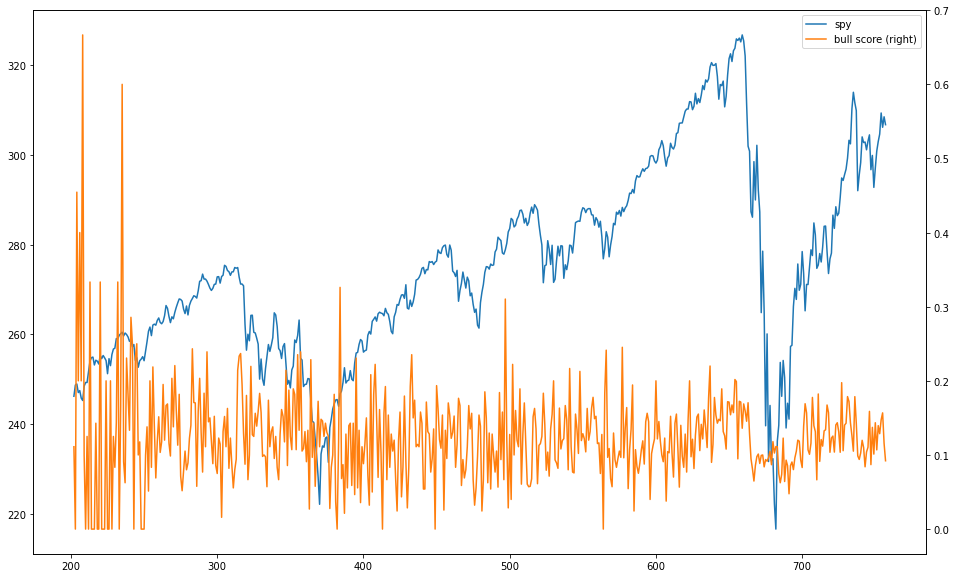

In [19]:
df_spy[['spy', 'bull score']].loc['2019-07-10':].plot(secondary_y='bull score', figsize=(16, 10));

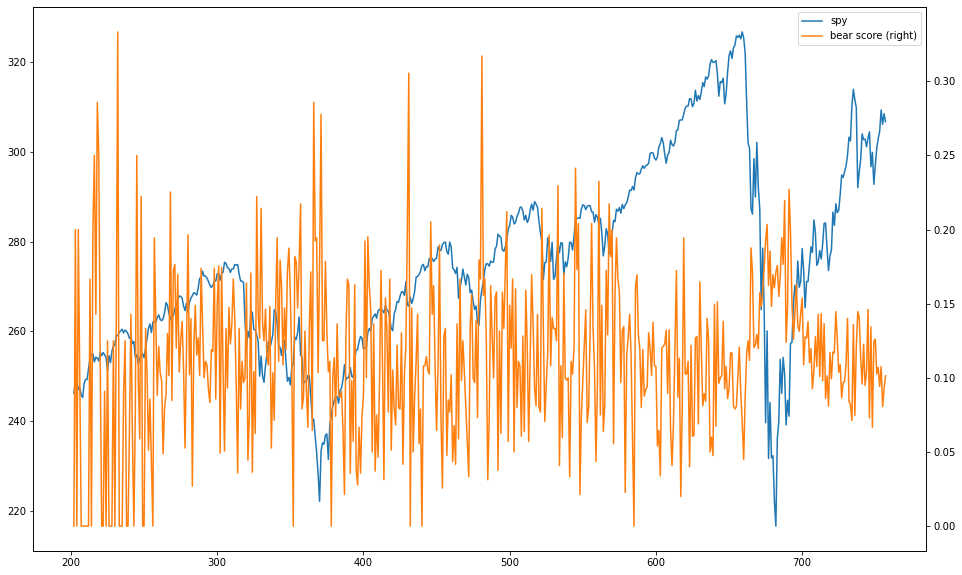

In [20]:
df_spy[['spy', 'bear score']].loc['2019-07-10':].plot(secondary_y='bear score', figsize=(16, 10));

In [21]:
## fourier transform

close_fft = np.fft.fft(np.asarray(df_spy['bull score'].tolist()))
fft_df = pd.DataFrame({'fft':close_fft})
fft_df['absolute'] = fft_df['fft'].apply(lambda x: np.abs(x))
fft_df['angle'] = fft_df['fft'].apply(lambda x: np.angle(x))
fft_list = np.asarray(fft_df['fft'].tolist())

for num_ in [10, 30]:
    fft_list_m10= np.copy(fft_list); fft_list_m10[num_:-num_]=0
    df_spy['fourier bull '+str(num_)]=np.fft.ifft(fft_list_m10)

close_fft = np.fft.fft(np.asarray(df_spy['bear score'].tolist()))
fft_df = pd.DataFrame({'fft':close_fft})
fft_df['absolute'] = fft_df['fft'].apply(lambda x: np.abs(x))
fft_df['angle'] = fft_df['fft'].apply(lambda x: np.angle(x))
fft_list = np.asarray(fft_df['fft'].tolist())

for num_ in [10, 30]:
    fft_list_m10= np.copy(fft_list); fft_list_m10[num_:-num_]=0
    df_spy['fourier bear '+str(num_)]=np.fft.ifft(fft_list_m10)

C:\Users\amanm\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\Users\amanm\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


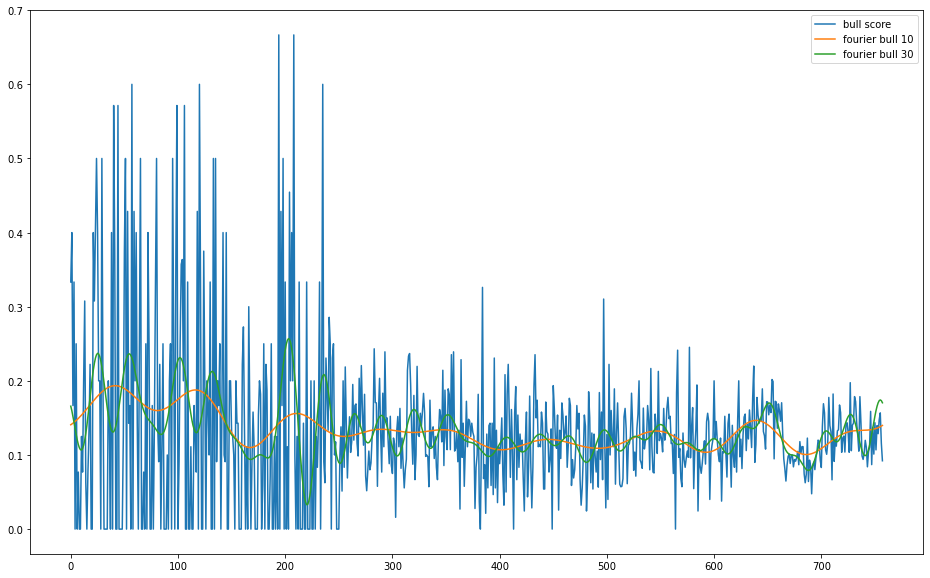

In [22]:
df_spy[['bull score', 'fourier bull 10', 'fourier bull 30']].plot(figsize=(16, 10));

C:\Users\amanm\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)
C:\Users\amanm\anaconda3\lib\site-packages\numpy\core\_asarray.py:102: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


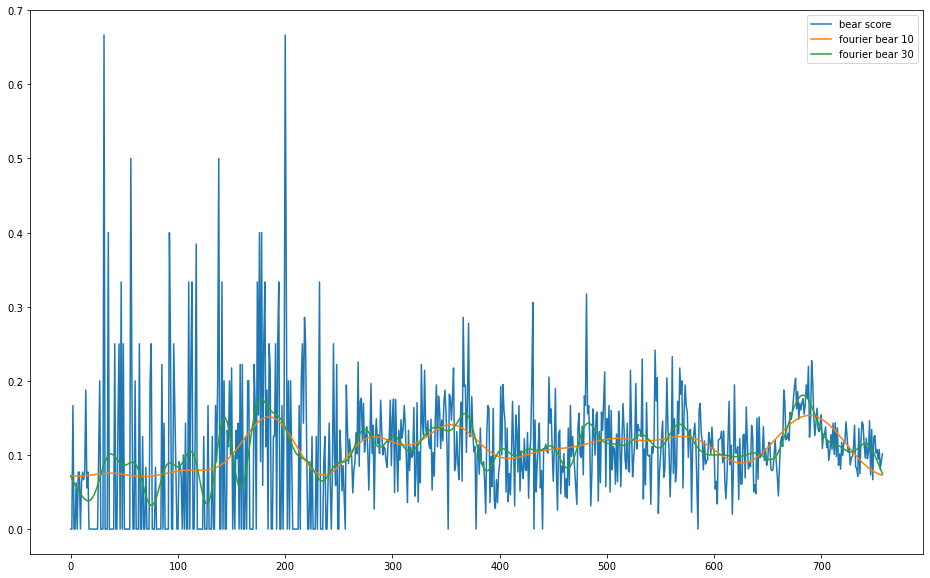

In [23]:
df_spy[['bear score', 'fourier bear 10', 'fourier bear 30']].plot(figsize=(16, 10));

In [24]:
#normalize
from sklearn.preprocessing import MinMaxScaler
sc= MinMaxScaler(feature_range=(0,1))
df_spy['norm_price']=sc.fit_transform(df_spy['spy'].to_numpy().reshape(-1, 1))
df_spy['spy log']=np.log(df_spy['spy']/df_spy['spy'].shift(1))
df_spy['norm_bull']=sc.fit_transform(df_spy['bull score'].to_numpy().reshape(-1, 1))
df_spy['norm_bear']=sc.fit_transform(df_spy['bear score'].to_numpy().reshape(-1, 1))
df_spy['norm_fourier_bull_10']=sc.fit_transform(np.asarray(list([(float(x)) for x in df_spy['fourier bull 10'].to_numpy()])).reshape(-1, 1))
df_spy['norm_fourier_bear_10']=sc.fit_transform(np.asarray(list([(float(x)) for x in df_spy['fourier bear 10'].to_numpy()])).reshape(-1, 1))
df_spy['norm_fourier_bull_30']=sc.fit_transform(np.asarray(list([(float(x)) for x in df_spy['fourier bull 30'].to_numpy()])).reshape(-1, 1))
df_spy['norm_fourier_bear_30']=sc.fit_transform(np.asarray(list([(float(x)) for x in df_spy['fourier bear 30'].to_numpy()])).reshape(-1, 1))

<ipython-input-24-80b71485d31a>:8: ComplexWarning: Casting complex values to real discards the imaginary part
  df_spy['norm_fourier_bull_10']=sc.fit_transform(np.asarray(list([(float(x)) for x in df_spy['fourier bull 10'].to_numpy()])).reshape(-1, 1))
<ipython-input-24-80b71485d31a>:9: ComplexWarning: Casting complex values to real discards the imaginary part
  df_spy['norm_fourier_bear_10']=sc.fit_transform(np.asarray(list([(float(x)) for x in df_spy['fourier bear 10'].to_numpy()])).reshape(-1, 1))
<ipython-input-24-80b71485d31a>:10: ComplexWarning: Casting complex values to real discards the imaginary part
  df_spy['norm_fourier_bull_30']=sc.fit_transform(np.asarray(list([(float(x)) for x in df_spy['fourier bull 30'].to_numpy()])).reshape(-1, 1))
<ipython-input-24-80b71485d31a>:11: ComplexWarning: Casting complex values to real discards the imaginary part
  df_spy['norm_fourier_bear_30']=sc.fit_transform(np.asarray(list([(float(x)) for x in df_spy['fourier bear 30'].to_numpy()])).re

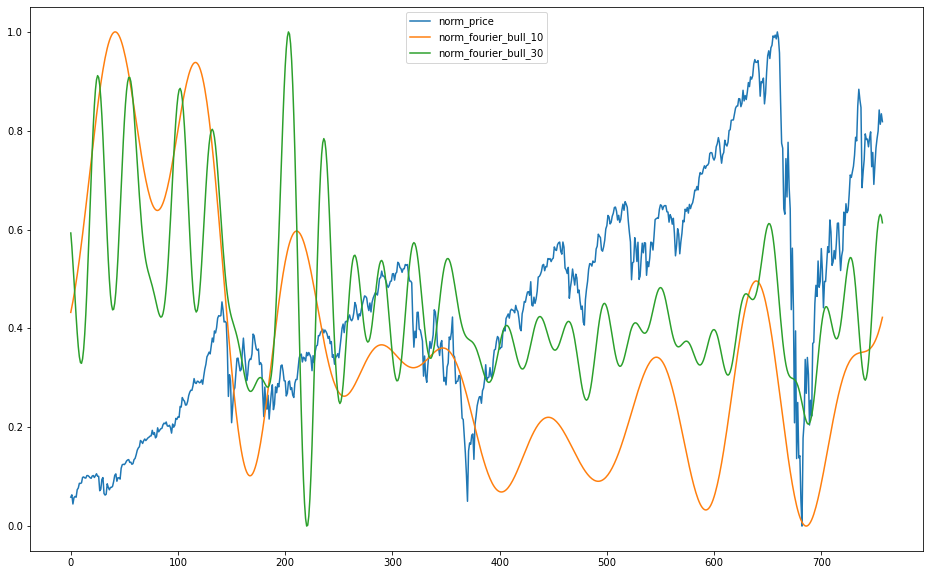

In [25]:
df_spy[['norm_price', 'norm_fourier_bull_10', 'norm_fourier_bull_30']].plot(figsize=(16, 10));

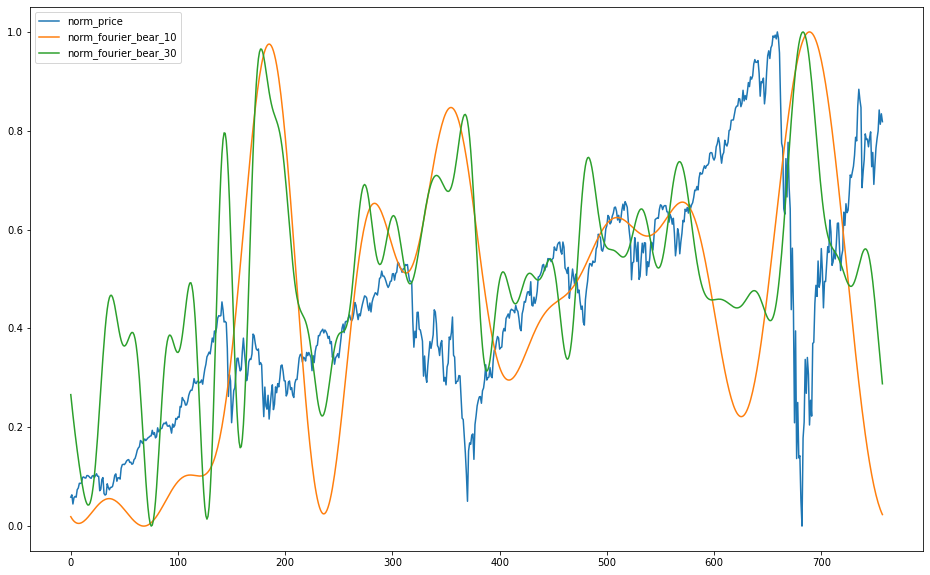

In [26]:
df_spy[['norm_price', 'norm_fourier_bear_10', 'norm_fourier_bear_30']].plot(figsize=(16, 10));

In [27]:
#function for numpy array manipulation in next cell
def remove_first(array):
    new_array=[]
    for x in array:
        new_array.append(x[1:])
    return np.asarray(new_array)

In [51]:
# get relevant columns and divide into train and test sets
df=df_spy[['norm_price', 'norm_bull', 'norm_bear', 'norm_fourier_bull_10', 
           'norm_fourier_bear_10', 'norm_fourier_bull_30', 'norm_fourier_bear_30']].to_numpy()
window=15
gap=1
data=[]
for x in range(len(df)-window): 
    data.append(df[x:x+window])
data=np.asarray(data)
train=data[:-50]
test=data[-50:]
np.random.shuffle(train)

X_train=[]
y_train=[]
for d in train:
    X_train.append(remove_first(d[:window-gap]))
    y_train.append(d[-1][0])

X_test=[]
y_test=[]
for d in test:
    X_test.append(remove_first(d[:window-gap]))
    y_test.append(d[-1][0])
    
X_train=np.asarray(X_train)
y_train=np.asarray(y_train)
X_test=np.asarray(X_test)
y_test=np.asarray(y_test)


In [141]:
df=df_spy[['norm_price', 'norm_bull', 'norm_bear', 'norm_fourier_bull_10', 
           'norm_fourier_bear_10', 'norm_fourier_bull_30', 'norm_fourier_bear_30']]
X_tpot = df_spy[['norm_price', 'norm_bull', 'norm_bear', 'norm_fourier_bull_10', 
           'norm_fourier_bear_10', 'norm_fourier_bull_30', 'norm_fourier_bear_30']]
y_tpot = df_spy['spy']

## Implement TPOT

In [142]:
tpot = TPOTRegressor(generations=10, population_size=100, verbosity=2, random_state=42)

In [143]:
# Split the data
X_train_tpot, X_test_tpot, y_train_tpot, y_test_tpot = train_test_split(X_tpot, y_tpot, test_size=0.3, random_state=42)

In [144]:
# Fit train data to model
tpot.fit(X_train_tpot, y_train_tpot)

Optimization Progress:   0%|          | 0/1100 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: -8.855246460298296e-28

Generation 2 - Current best internal CV score: -8.855246460298296e-28

Generation 3 - Current best internal CV score: -8.855246460298296e-28

Generation 4 - Current best internal CV score: -8.519935923075297e-28

Generation 5 - Current best internal CV score: -8.519935923075297e-28

Generation 6 - Current best internal CV score: -6.340417431125802e-28

Generation 7 - Current best internal CV score: -6.340417431125802e-28

Generation 8 - Current best internal CV score: -6.340417431125802e-28

Generation 9 - Current best internal CV score: -6.340417431125802e-28

Generation 10 - Current best internal CV score: -6.172762162514303e-28

Best pipeline: LassoLarsCV(SGDRegressor(input_matrix, alpha=0.01, eta0=0.1, fit_intercept=False, l1_ratio=0.75, learning_rate=invscaling, loss=huber, penalty=elasticnet, power_t=0.5), normalize=True)


TPOTRegressor(generations=10, random_state=42, verbosity=2)

In [145]:
# Model performance metrics
from sklearn.metrics import mean_squared_error
print('MSE:')
print(mean_squared_error(y_test_tpot, tpot.predict(X_test_tpot)))

MSE:
5.845874497637814e-28


As we can see that for the TPOT Regressor, the mean squared error is very low. This shows that our model is very accurate and the data used to predict the model is very well structured and detailed.

In [146]:
print('RMSE:')
print(np.sqrt(mean_squared_error(y_test_tpot, tpot.predict(X_test_tpot))))

RMSE:
2.417824331426461e-14


The root mean squared is also very low indicating that the model's performance is very good for real data.

In [125]:
# Export the tpot pipeline
tpot.export('tpot_stock_price_pipeline.py')

## LSTM Model

In [133]:
# Create Keras model
tf.keras.backend.clear_session()
tf.random.set_seed(51)
np.random.seed(51)

mc=tf.keras.callbacks.ModelCheckpoint(filepath='lstm_bullbear_sentiment_1.h5', monitor='val_loss', save_best_only=True)
model = tf.keras.models.Sequential([
    tf.keras.layers.LSTM(48, return_sequences=True, input_shape=(X_train.shape[1],X_train.shape[2])),
    tf.keras.layers.LSTM(48,return_sequences=True),
    tf.keras.layers.LSTM(48),
    tf.keras.layers.Dense(24, activation="relu"),
    tf.keras.layers.Dense(12, activation="relu"),
    tf.keras.layers.Dense(1),
])

model.compile(optimizer='adam', loss='mean_squared_error', metrics=['accuracy'])


### Please note that this model is not for predicting the stock price, rather, it is to predict the price curve for the stock.

In [138]:
history = model.fit(X_train, y_train, batch_size=32, validation_data= [X_test, y_test], epochs=250, callbacks=[mc])

Epoch 1/250
22/22 [==============================] - 0s 19ms/step - loss: 6.6707e-04 - accuracy: 0.0029 - val_loss: 0.0512 - val_accuracy: 0.0000e+00
Epoch 2/250
22/22 [==============================] - 0s 21ms/step - loss: 5.7473e-04 - accuracy: 0.0029 - val_loss: 0.0520 - val_accuracy: 0.0000e+00
Epoch 3/250
22/22 [==============================] - 0s 20ms/step - loss: 5.0497e-04 - accuracy: 0.0029 - val_loss: 0.0486 - val_accuracy: 0.0000e+00
Epoch 4/250
22/22 [==============================] - 0s 21ms/step - loss: 4.5670e-04 - accuracy: 0.0029 - val_loss: 0.0491 - val_accuracy: 0.0000e+00
Epoch 5/250
22/22 [==============================] - 0s 19ms/step - loss: 4.2699e-04 - accuracy: 0.0029 - val_loss: 0.0506 - val_accuracy: 0.0000e+00
Epoch 6/250
22/22 [==============================] - 0s 19ms/step - loss: 4.2570e-04 - accuracy: 0.0029 - val_loss: 0.0484 - val_accuracy: 0.0000e+00
Epoch 7/250
22/22 [==============================] - 0s 19ms/step - loss: 4.8581e-04 - accuracy: 0.0

22/22 [==============================] - 0s 18ms/step - loss: 3.5064e-04 - accuracy: 0.0029 - val_loss: 0.0508 - val_accuracy: 0.0000e+00
Epoch 56/250
22/22 [==============================] - 0s 19ms/step - loss: 5.0398e-04 - accuracy: 0.0029 - val_loss: 0.0550 - val_accuracy: 0.0000e+00
Epoch 57/250
22/22 [==============================] - 0s 18ms/step - loss: 3.5660e-04 - accuracy: 0.0029 - val_loss: 0.0491 - val_accuracy: 0.0000e+00
Epoch 58/250
22/22 [==============================] - 0s 20ms/step - loss: 3.8233e-04 - accuracy: 0.0029 - val_loss: 0.0534 - val_accuracy: 0.0000e+00
Epoch 59/250
22/22 [==============================] - 0s 19ms/step - loss: 4.8244e-04 - accuracy: 0.0029 - val_loss: 0.0530 - val_accuracy: 0.0000e+00
Epoch 60/250
22/22 [==============================] - 0s 19ms/step - loss: 5.1096e-04 - accuracy: 0.0029 - val_loss: 0.0573 - val_accuracy: 0.0000e+00
Epoch 61/250
22/22 [==============================] - 0s 18ms/step - loss: 4.3243e-04 - accuracy: 0.0029 - 

22/22 [==============================] - 0s 18ms/step - loss: 3.4678e-04 - accuracy: 0.0029 - val_loss: 0.0604 - val_accuracy: 0.0000e+00
Epoch 110/250
22/22 [==============================] - 0s 17ms/step - loss: 3.2075e-04 - accuracy: 0.0029 - val_loss: 0.0612 - val_accuracy: 0.0000e+00
Epoch 111/250
22/22 [==============================] - 0s 17ms/step - loss: 3.7529e-04 - accuracy: 0.0029 - val_loss: 0.0587 - val_accuracy: 0.0000e+00
Epoch 112/250
22/22 [==============================] - 0s 17ms/step - loss: 3.0173e-04 - accuracy: 0.0029 - val_loss: 0.0588 - val_accuracy: 0.0000e+00
Epoch 113/250
22/22 [==============================] - 0s 18ms/step - loss: 4.0019e-04 - accuracy: 0.0029 - val_loss: 0.0560 - val_accuracy: 0.0000e+00
Epoch 114/250
22/22 [==============================] - 0s 17ms/step - loss: 3.6377e-04 - accuracy: 0.0029 - val_loss: 0.0579 - val_accuracy: 0.0000e+00
Epoch 115/250
22/22 [==============================] - 0s 17ms/step - loss: 3.9558e-04 - accuracy: 0.0

Epoch 163/250
22/22 [==============================] - 0s 18ms/step - loss: 5.1469e-04 - accuracy: 0.0029 - val_loss: 0.0614 - val_accuracy: 0.0000e+00
Epoch 164/250
22/22 [==============================] - 0s 17ms/step - loss: 4.3677e-04 - accuracy: 0.0029 - val_loss: 0.0604 - val_accuracy: 0.0000e+00
Epoch 165/250
22/22 [==============================] - 0s 18ms/step - loss: 3.6610e-04 - accuracy: 0.0029 - val_loss: 0.0571 - val_accuracy: 0.0000e+00
Epoch 166/250
22/22 [==============================] - 0s 18ms/step - loss: 3.7568e-04 - accuracy: 0.0029 - val_loss: 0.0585 - val_accuracy: 0.0000e+00
Epoch 167/250
22/22 [==============================] - 0s 18ms/step - loss: 3.5023e-04 - accuracy: 0.0029 - val_loss: 0.0585 - val_accuracy: 0.0000e+00
Epoch 168/250
22/22 [==============================] - 0s 18ms/step - loss: 3.5174e-04 - accuracy: 0.0029 - val_loss: 0.0597 - val_accuracy: 0.0000e+00
Epoch 169/250
22/22 [==============================] - 0s 18ms/step - loss: 3.0433e-04 -

Epoch 217/250
22/22 [==============================] - 0s 18ms/step - loss: 4.5158e-04 - accuracy: 0.0029 - val_loss: 0.0604 - val_accuracy: 0.0000e+00
Epoch 218/250
22/22 [==============================] - 0s 18ms/step - loss: 4.9762e-04 - accuracy: 0.0029 - val_loss: 0.0714 - val_accuracy: 0.0000e+00
Epoch 219/250
22/22 [==============================] - 0s 18ms/step - loss: 0.0010 - accuracy: 0.0029 - val_loss: 0.0591 - val_accuracy: 0.0000e+00
Epoch 220/250
22/22 [==============================] - 0s 17ms/step - loss: 0.0045 - accuracy: 0.0029 - val_loss: 0.0597 - val_accuracy: 0.0000e+00
Epoch 221/250
22/22 [==============================] - 0s 17ms/step - loss: 0.0054 - accuracy: 0.0029 - val_loss: 0.0774 - val_accuracy: 0.0000e+00
Epoch 222/250
22/22 [==============================] - 0s 18ms/step - loss: 0.0028 - accuracy: 0.0029 - val_loss: 0.0550 - val_accuracy: 0.0000e+00
Epoch 223/250
22/22 [==============================] - 0s 18ms/step - loss: 0.0014 - accuracy: 0.0029 - 

<function matplotlib.pyplot.show(close=None, block=None)>

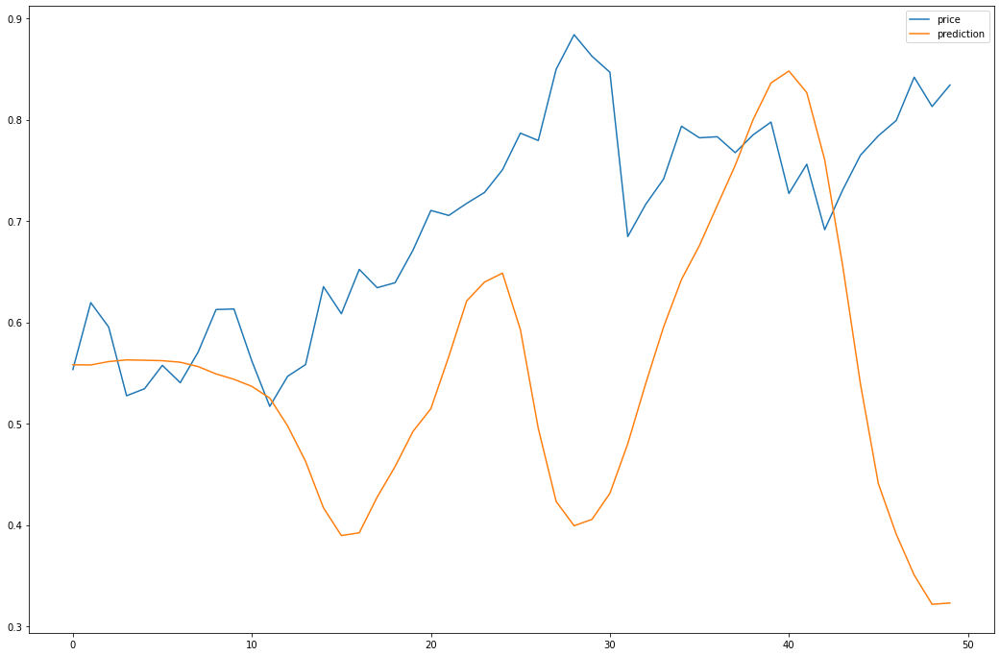

In [140]:
#predictions
pred=model.predict(X_test)
    
df_predictions=pd.DataFrame(y_test, columns = ['price']) 
df_predictions['prediction']=pred

df_predictions.plot(figsize=(18,12))
plt.show

From the above graph it can be clearly seen that the curve generated by the prediction data precedes the curve generated by the real data. We can see that the predicted data indicated the upward movement from point 15 to 20 and the same movement curve was refleted in the real data from point 28 to 30. The similar repetetion can be seen for the downward curve as well the model predicted a downward movement within points 22 to 27 and the same curve was replicated in the real time data from points 28 to 30.

In [32]:
print('MEA: ', sum(tf.keras.metrics.mean_absolute_error(y_test, pred).numpy())/len(y_test))

MEA:  0.19110118642449378



# Conclusion

The sentimental analysis on the posts along with the various data transformations provided the model with a lot of parameters to train itself and hence the model outcome is good.
From the above models and graphs, we can see that the model performances for both TPOT and LSTM have been very good. Since the data was extracted using API, it was a real time production data and hence considering that the model performed well in predicting the future price curve in advance. 
